# __Stroke Prediction__


## __Contents:__
> 1. Overview
> 2. Installation
> 3. Read the dataset
> 4. Explore Information
> 5. Cleaning the dataset
>> 1. Handling whitespaces
>> 2. Handling the Missing Values
>> 3. Handling unnecessary Values
>> 4. Handling the Outliers
> 6. Explore Data Analysis
>> 1. Questions & Answers



## __Overview:__

In this project we take the dataset from kaggle [here](https://www.kaggle.com/fedesoriano/stroke-prediction-dataset/code?datasetId=1120859&sortBy=voteCount)


# <hr>

## __Installation:__

In [45]:
# !pip install plotly_express
!pip install pywaffle

     |████████████████████████████████| 526 kB 457 kB/s eta 0:00:01


In [46]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from pywaffle import Waffle

%matplotlib inline
%config InlineBackend.figure_format = 'svg'

# <hr>

## __Read the Dataset:__

In [4]:
# Read Dataset
df = pd.read_csv('data/stroke-data.csv')
df_eda = df.copy()
df.head()

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,9046,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1
1,51676,Female,61.0,0,0,Yes,Self-employed,Rural,202.21,NaN,never smoked,1
2,31112,Male,80.0,0,1,Yes,Private,Rural,105.92,32.5,never smoked,1
3,60182,Female,49.0,0,0,Yes,Private,Urban,171.23,34.4,smokes,1
4,1665,Female,79.0,1,0,Yes,Self-employed,Rural,174.12,24.0,never smoked,1


In [5]:
df_eda.smoking_status.value_counts()

never smoked       1892
Unknown            1544
formerly smoked     885
smokes              789
Name: smoking_status, dtype: int64

# <hr>

## __Cleaning the Dataset:__

### Explore the data and the correlations

In [6]:
plt.figure(figsize = (7,7))
sns.pairplot(df)

<Figure size 504x504 with 0 Axes>

### Handling whitespaces:

In [7]:
# strip whitespaces in columns
df.columns.str.strip()

Index(['id', 'gender', 'age', 'hypertension', 'heart_disease', 'ever_married',
       'work_type', 'Residence_type', 'avg_glucose_level', 'bmi',
       'smoking_status', 'stroke'],
      dtype='object')

In [8]:
# strip whitespaces in values of multiple columns
cols = ['gender', 'ever_married', 'work_type','Residence_type','smoking_status']
df[cols] = df[cols].apply(lambda x: x.str.strip())

### Handling the Missing Values:

In [9]:
# Check for null values
df_eda.isna().sum()

id                     0
gender                 0
age                    0
hypertension           0
heart_disease          0
ever_married           0
work_type              0
Residence_type         0
avg_glucose_level      0
bmi                  201
smoking_status         0
stroke                 0
dtype: int64

In [10]:
df_eda.bmi.mean()

28.893236911794673

In [11]:
df_eda.bmi.median()

28.1

In [12]:
# fill null values in bmi column
df_eda.bmi= df_eda.bmi.fillna(df_eda.bmi.mean())

In [13]:
df_eda.isna().sum()

id                   0
gender               0
age                  0
hypertension         0
heart_disease        0
ever_married         0
work_type            0
Residence_type       0
avg_glucose_level    0
bmi                  0
smoking_status       0
stroke               0
dtype: int64

In [14]:
df_eda.smoking_status.value_counts()

never smoked       1892
Unknown            1544
formerly smoked     885
smokes              789
Name: smoking_status, dtype: int64

### Unnecessary Values:

In [15]:
# Round up the age 
df_eda.age = df_eda.age.round().astype('int')

In [16]:
# Delete 'id' column 
df_eda = df_eda.drop('id', axis=1)

### Handling the Outliers:

In [17]:
fig = px.box(df_eda, x="work_type", y="age" , color='hypertension') 
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

In [18]:
fig = px.box(df_eda, x="smoking_status", y="age" , color='work_type') 
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

In [19]:
fig = px.box(df_eda, x="gender", y="age" , color='stroke') 
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

> We can see here a weird category in the gender so we will delete this category


In [20]:
# # Drop 'Other' Because only one patient has 'other'
df_eda.drop(df_eda.loc[df_eda['gender']=='Other'].index, inplace=True)

In [21]:
# # now we will handle the outlier
# df_eda= df_eda.loc[df_eda['age']== 1 and df_eda['stroke']== 1].replace(df_eda['stroke']== 0)
# df_eda

In [22]:
df_eda

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,Male,67,0,1,Yes,Private,Urban,228.69,36.600000,formerly smoked,1
1,Female,61,0,0,Yes,Self-employed,Rural,202.21,28.893237,never smoked,1
2,Male,80,0,1,Yes,Private,Rural,105.92,32.500000,never smoked,1
3,Female,49,0,0,Yes,Private,Urban,171.23,34.400000,smokes,1
4,Female,79,1,0,Yes,Self-employed,Rural,174.12,24.000000,never smoked,1
...,...,...,...,...,...,...,...,...,...,...,...
5105,Female,80,1,0,Yes,Private,Urban,83.75,28.893237,never smoked,0
5106,Female,81,0,0,Yes,Self-employed,Urban,125.20,40.000000,never smoked,0
5107,Female,35,0,0,Yes,Self-employed,Rural,82.99,30.600000,never smoked,0
5108,Male,51,0,0,Yes,Private,Rural,166.29,25.600000,formerly smoked,0


In [23]:
fig = px.box(df_eda, x="heart_disease", y="age" , color='stroke') 
fig.update_traces(quartilemethod="exclusive") # or "inclusive", or "linear" by default
fig.show()

# <hr>

## __Explore Data Analysis:__

### Questions & Answers:

#### 1. Does age has impact on strokes?

In [24]:
# Code
age_group = df_eda.groupby(['age' ,'stroke'] , as_index=False)[['stroke']].count()
age_group

,age,stroke
0,0,20
1,1,64
2,1,1
3,2,90
4,3,46
...,...,...
122,80,17
123,81,46
124,81,14
125,82,47


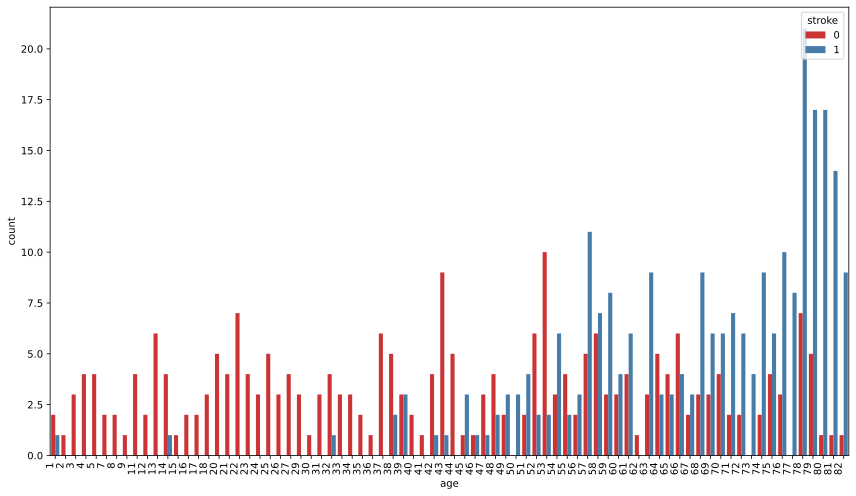

In [25]:
# Visual
plt.figure(figsize = (12,7))
# sns.countplot(data=df_eda,x='age' , hue='stroke' )
# Draw with seaborn
ax = sns.countplot(x= "age" , hue= "stroke" , data= df_eda.head(500) , palette="Set1" );
ax.set_xticklabels(ax.get_xticklabels(), rotation= 90, ha="right");
plt.tight_layout()


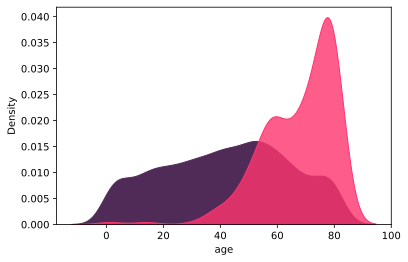

In [40]:
sns.kdeplot(data = df[df['stroke'] == 0], x = 'age', shade = True,  alpha = 1, legend=True, color = '#512b58' );
sns.kdeplot(data = df[df['stroke'] == 1], x = 'age', shade = True,  alpha = 0.8, legend=True, color = '#fe346e');

#### 2. Does body mass index and glucose levels in a person, propel a stroke?

In [26]:
# Code 

In [27]:
# Code
bmi_group = df_eda.groupby(['bmi','avg_glucose_level'] , as_index=False)[['stroke']].sum().sort_values(ascending=False, by='stroke')
bmi_group.head(60)

,bmi,avg_glucose_level,stroke
2797,28.893237,101.45,2
2823,28.893237,114.77,1
2832,28.893237,169.67,1
4841,42.500000,112.16,1
2831,28.893237,167.13,1
2830,28.893237,165.31,1
577,20.200000,213.03,1
3373,30.800000,78.18,1
3115,29.700000,79.79,1
3116,29.700000,80.43,1


In [28]:
# Visual


#### 3. Assumption: Smoking can induce Stroke, is it true?

In [29]:
# Code
smoke_group = df_eda.groupby('smoking_status' )[['stroke']].sum()
smoke_group

,stroke
smoking_status,
Unknown,47
formerly smoked,70
never smoked,90
smokes,42


In [30]:
one_d_cho = smoke_group.values.flatten()
one_d_cho

array([47, 70, 90, 42])

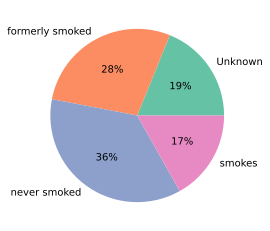

In [31]:
# Visual
colors = sns.color_palette(palette='Set2')
labels =['Unknown' , 'formerly smoked' ,'never smoked' , 'smokes']
plt.pie(one_d_cho ,labels=labels  , autopct='%.0f%%', colors=colors)
plt.show()

#### 4. Assumption: Heart with a Heart Disease is prone to Stroke, is it true?

In [32]:
# Code
heart_group = df_eda.groupby(['heart_disease' ,'stroke'], as_index=False)[['stroke']].count()
heart_group

,heart_disease,stroke
0,0,4631
1,0,202
2,1,229
3,1,47


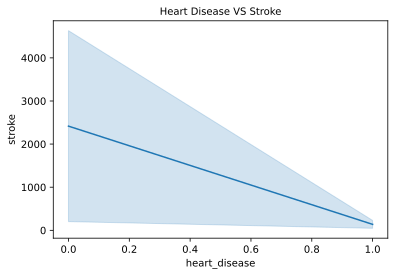

In [33]:
# Visual
sns.lineplot(x='heart_disease', y='stroke', palette="Blues_d", data=heart_group);
plt.title('Heart Disease VS Stroke', size=10)
plt.xlabel('heart_disease', size=10)
plt.ylabel('stroke', size=10);

In [34]:
# Visual
# sns.relplot(data=df, x="Duration", y="Calories", hue="Gender", col="Gender");

#### 5. Assumption: Workload results in high blood pressure and that could lead to Stroke, is it true?

In [35]:
# Code
work_group = df_eda.groupby(['work_type' , 'hypertension'],as_index=False)[['stroke']].sum()
work_group

,work_type,hypertension,stroke
0,Govt_job,0,25
1,Govt_job,1,8
2,Never_worked,0,0
3,Private,0,116
4,Private,1,33
5,Self-employed,0,40
6,Self-employed,1,25
7,children,0,2


In [47]:
# Visual

work = df_eda['work_type'].value_counts()
stroke_work = df_eda[df_eda['stroke'] == 1]['work_type'].value_counts()
healthy_work = df_eda[df_eda['stroke'] == 0]['work_type'].value_counts()

private = work.values[0]
self =  work.values[1]
child = work.values[2]
gov = work.values[3]
never = work.values[4]

stroke_private = int(round (stroke_work.values[0] / private * 100, 0))
stroke_self = int(round( stroke_work.values[1]  / self *100, 0))
stroke_child = int(round (stroke_work.values[3]  / child * 100, 0))
stroke_gov = int(round( stroke_work.values[2]  / gov *100, 0))
stroke_never = int(round( 0, 0))

healthy_private = int(round(healthy_work.values[0] / private * 100, 0))
healthy_self = int(round(healthy_work.values[1] / self *100, 0))
healthy_child = int(round(healthy_work.values[2] / child * 100, 0))
healthy_gov = int(round(healthy_work.values[3]/ gov *100, 0))
healthy_never = int(round(healthy_work.values[4]/ never *100, 0))

private_per = int(round(private/(private+self+child+gov+never) * 100, 0))
self_per = int(round(self/(private+self+child+gov+never)* 100, 0))
child_per = int(round(child/(private+self+child+gov+never) * 100, 0))
gov_per = int(round(gov/(private+self+child+gov+never)* 100, 0))
never_per = int(round(never/(private+self+child+gov+never)* 100, 0))


<ipython-input-56-7a9e88797e12>:117: MatplotlibDeprecationWarning:

Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later

<ipython-input-56-7a9e88797e12>:119: MatplotlibDeprecationWarning:

Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later



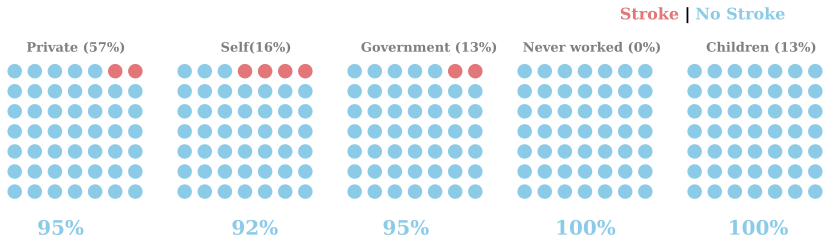

In [56]:
# figure

fig = plt.figure(FigureClass = Waffle, 
                 constrained_layout = True,
                 figsize = (15,15),
                 facecolor = '#ffff',dpi = 100,
                 
                 plots = {'151':
                          {     
                           'rows':7,
                           'columns': 7,
                           'values' : [stroke_private,healthy_private],
                            'colors' : ['#E37678','#8BCBE8'],
                              'vertical' : True,
                              'interval_ratio_x': 0.005,
                              'interval_ratio_y': 0.005,
                              'icons' : 'circle',
                              'icon_legend': False,
                              'icon_size':15,
                              'plot_anchor':'C',
                              'alpha':0.2,
                              'starting_location': 'NE'
                          },
                          
                          '152' :
                          { 
                            'rows': 7,
                            'columns':7,
                            'values':[stroke_self,healthy_self],         
                              'colors' : ['#E37678','#8BCBE8'],
                              'vertical': True,
                              'interval_ratio_x': 0.005,
                              'interval_ratio_y':0.005,
                              'icons' : 'circle',
                              'icon_legend' :False,
                              'icon_size':15,
                              'plot_anchor':'C',
                              'alpha':0.2,
                              'starting_location': 'NE'
                                                      
                           },
                          
                          '153':
                          {     
                           'rows':7,
                           'columns': 7,
                           'values' : [stroke_gov,healthy_gov],
                            'colors' : ['#E37678','#8BCBE8'],
                              'vertical' : True,
                              'interval_ratio_x': 0.005,
                              'interval_ratio_y': 0.005,
                              'icons' : 'circle',
                              'icon_legend': False,
                              'icon_size':15,
                              'plot_anchor':'C',
                              'alpha':0.2,
                              'starting_location': 'NE'
                          },
                          
                          '154' :
                          { 
                            'rows': 7,
                            'columns':7,
                            'values':[stroke_never,healthy_never],         
                              'colors' : ['#E37678','#8BCBE8'],
                              'vertical': True,
                              'interval_ratio_x': 0.006,
                              'interval_ratio_y':0.006,
                              'icons' : 'circle',
                              'icon_legend' :False,
                              'icon_size':15,
                              'plot_anchor':'C',
                              'alpha':0.2,
                              'starting_location': 'NE'
                                                      
                           },
                          
                          '155' :
                          { 
                            'rows': 7,
                            'columns':7,
                            'values':[stroke_child,healthy_child],         
                              'colors' : ['#E37678','#8BCBE8'],
                              'vertical': True,
                              'interval_ratio_x': 0.006,
                              'interval_ratio_y':0.006,
                              'icons' : 'circle',
                              'icon_legend' :False,
                              'icon_size':15,
                              'plot_anchor':'C',
                              'alpha':0.2,
                              'starting_location': 'NE'
                                                      
                           }
                          
                         },
                   
);


# Percentage

fig.text(0.16, 0.40, '{}%'.format(healthy_private), {'font':'Serif', 'size':20,'weight':'bold' ,'color':'#8BCBE8'},alpha = 1,);
fig.text(0.34, 0.40, '{}%'.format(healthy_self), {'font':'Serif', 'size':20,'weight':'bold', 'color':'#8BCBE8'}, alpha = 1);
fig.text(0.48, 0.40, '{}%'.format(healthy_gov), {'font':'Serif', 'size':20,'weight':'bold' ,'color':'#8BCBE8'},alpha = 1,);
fig.text(0.64, 0.40, '{}%'.format(healthy_never), {'font':'Serif', 'size':20,'weight':'bold', 'color':'#8BCBE8'}, alpha = 1);
fig.text(0.8, 0.40, '{}%'.format(healthy_child), {'font':'Serif', 'size':20,'weight':'bold', 'color':'#8BCBE8'}, alpha = 1);

# Labels
fig.text(0.15, 0.57, 'Private ({}%)'.format(private_per), {'font':'Serif', 'size':13,'weight':'bold' ,'color':'black'},alpha = 0.5,);
fig.text(0.33, 0.57, "Self({}%)".format(self_per), {'font':'Serif', 'size':13,'weight':'bold', 'color':'black'}, alpha = 0.5);
fig.text(0.46, 0.57, 'Government ({}%)'.format(gov_per), {'font':'Serif', 'size':13,'weight':'bold' ,'color':'black'},alpha = 0.5,);
fig.text(0.61, 0.57, "Never worked ({}%)".format(never_per), {'font':'Serif', 'size':13,'weight':'bold', 'color':'black'}, alpha = 0.5);
fig.text(0.78, 0.57, "Children ({}%)".format(child_per), {'font':'Serif', 'size':13,'weight':'bold', 'color':'black'}, alpha = 0.5) ; 

# Legend
fig.text(0.7,0.6, 'Stroke ', {'font': 'Serif','weight':'bold','Size': '16','weight':'bold','style':'normal', 'color':'#E37678'});
fig.text(0.76,0.6, '|', {'color':'black' , 'size':'16', 'weight': 'bold'});
fig.text(0.77,0.6, 'No Stroke', {'font': 'Serif','weight':'bold', 'Size': '16','style':'normal', 'weight':'bold','color':'#8BCBE8'},alpha = 1);

#### 6. Assumption: Males are most susceptible to strokes due to high work related stress, is it true

In [37]:
# Code
gender_group = df_eda.groupby('gender')[['stroke']].sum()
gender_group

,stroke
gender,
Female,141
Male,108


In [38]:
# Visual

